**Author:** Elias Rafael Ruiz-Morales

**Institution:** Wellcome Sanger institute

**May, 2022**

Cell type annotations after logistic regression


----

# Annotation of cell types after logistic regression


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import os
import sys
import anndata
import scvi


In [2]:
def MovePlots(plotpattern, subplotdir):
    os.system('mkdir -p '+str(sc.settings.figdir)+'/'+subplotdir)
    os.system('mv '+str(sc.settings.figdir)+'/*'+plotpattern+'** '+str(sc.settings.figdir)+'/'+subplotdir)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = '../results/images/integrated/annotation/'
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=200)  # low dpi (dots per inch) yields small inline figures

sys.executable

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
absl                NA
anndata             0.7.5
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyterlab_server   2.3.0
kiw

'/opt/conda/bin/python'

In [37]:
#Function to add the souporcell id

def add_souporcell_id(adata_obj, cell_id, souporcell_clusters):
    '''
    Function to add the souporcell status (e.g. 0,1, not pooled, etc.) to the cells
    
    Input
        adata_obj: adata object
        cell_id: id of a cell
    
    '''
    
    curr_sample = adata_obj.obs.loc[cell_id, 'sample']
    
    #print('sample',sample, 'barcode', cell_id)
    
    if curr_sample in samples:
        #extracts the table contained in the indicated key of the dictionary
        curr_souporcell_table = souporcell_clusters[curr_sample]
        
        if (cell_id in list(curr_souporcell_table.index)): #checking that the cells are into the data
            curr_assign = souporcell_clusters[curr_sample].loc[cell_id,'assignment']
            #print('returning',curr_assign)
            return(curr_assign)

        else:
            # cell barcode is filtered by souporcell
            return('filtered_by_souporcell')
    else:
        return('not_pooled')

## Loading data

In [4]:
adata= sc.read('../results/scVI/S2_scVIintegrated_adata_latent30_20220523.h5ad')

# Loading log regression label transfering

In [3]:
prediction= pd.read_csv('../results/log_regression/logreg_from_MFI_downsampled_fine_troph_to_explant_premrna_HVGs_predictions_20220524.csv', index_col=0)

In [5]:
prediction

,celltype_predictions,probabilities
Pla_HDBR10917729_AAACCCACATCGAACT,VCT_CCC,0.979785
Pla_HDBR10917729_AAACCCAGTAAGACCG,PV,0.664456
Pla_HDBR10917729_AAACCCAGTGGGATTG,VCT_CCC,0.387121
Pla_HDBR10917729_AAACGAAAGCCTAACT,dS1,0.310120
Pla_HDBR10917729_AAACGAAAGCCTGGAA,fF1,0.940927
...,...,...
Pla_HDBR12808831_TTTGTTGTCCAAGAGG,dM2,0.343932
Pla_HDBR12808831_TTTGTTGTCGGTCATA,dS2,0.661502
Pla_HDBR12808831_TTTGTTGTCTCGACGG,HOFB,0.865360
Pla_HDBR12808831_TTTGTTGTCTGTGCTC,dM2,0.532728


In [6]:
adata.obs= adata.obs.join(prediction)

In [7]:
adata.obs

,sample,donor,termination,day,pcw,percent_mito,n_counts,batch,n_genes,sample_barcode,...,G2M_score,phase,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,scrublet_doublet,leiden_scvi,celltype_predictions,probabilities
Pla_HDBR10917729_AAACCCACATCGAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.004617,6715.0,0,1938,Pla_HDBR10917729_AAACCCACATCGAACT,...,-0.228714,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.979785
Pla_HDBR10917729_AAACCCAGTAAGACCG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.008159,858.0,0,449,Pla_HDBR10917729_AAACCCAGTAAGACCG,...,0.299731,G2M,0,0,9.330803,1.336784,singlet,11,PV,0.664456
Pla_HDBR10917729_AAACCCAGTGGGATTG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.005693,1581.0,0,779,Pla_HDBR10917729_AAACCCAGTGGGATTG,...,-0.084019,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.387121
Pla_HDBR10917729_AAACGAAAGCCTAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.047304,3023.0,0,1178,Pla_HDBR10917729_AAACGAAAGCCTAACT,...,0.865733,G2M,0,0,9.330803,1.336784,singlet,11,dS1,0.310120
Pla_HDBR10917729_AAACGAAAGCCTGGAA,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.066152,11005.0,0,3605,Pla_HDBR10917729_AAACGAAAGCCTGGAA,...,-0.146854,S,0,0,9.330803,1.336784,singlet,1,fF1,0.940927
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pla_HDBR12808831_TTTGTTGTCCAAGAGG,Pla_HDBR12808831,Hrv141+Hrv142,surgical,d2,12pcw,0.077964,14404.0,15,4058,Pla_HDBR12808831_TTTGTTGTCCAAGAGG,...,0.148042,G2M,9,0,9.661806,0.781609,singlet,0,dM2,0.343932
Pla_HDBR12808831_TTTGTTGTCGGTCATA,Pla_HDBR12808831,Hrv141+Hrv142,surgical,d2,14pcw_12pcw,0.046711,4089.0,15,1990,Pla_HDBR12808831_TTTGTTGTCGGTCATA,...,-0.077481,G1,10,0,8.367895,1.430727,singlet,3,dS2,0.661502
Pla_HDBR12808831_TTTGTTGTCTCGACGG,Pla_HDBR12808831,Hrv141+Hrv142,surgical,d2,12pcw,0.021751,19355.0,15,4116,Pla_HDBR12808831_TTTGTTGTCTCGACGG,...,-0.144484,G1,9,0,9.661806,0.781609,singlet,0,HOFB,0.865360
Pla_HDBR12808831_TTTGTTGTCTGTGCTC,Pla_HDBR12808831,Hrv141+Hrv142,surgical,d2,14pcw,0.039958,23550.0,15,5239,Pla_HDBR12808831_TTTGTTGTCTGTGCTC,...,-0.152948,G1,8,0,9.532544,1.064018,singlet,0,dM2,0.532728


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:31)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:01:20)
... storing 'celltype_predictions' as categorical


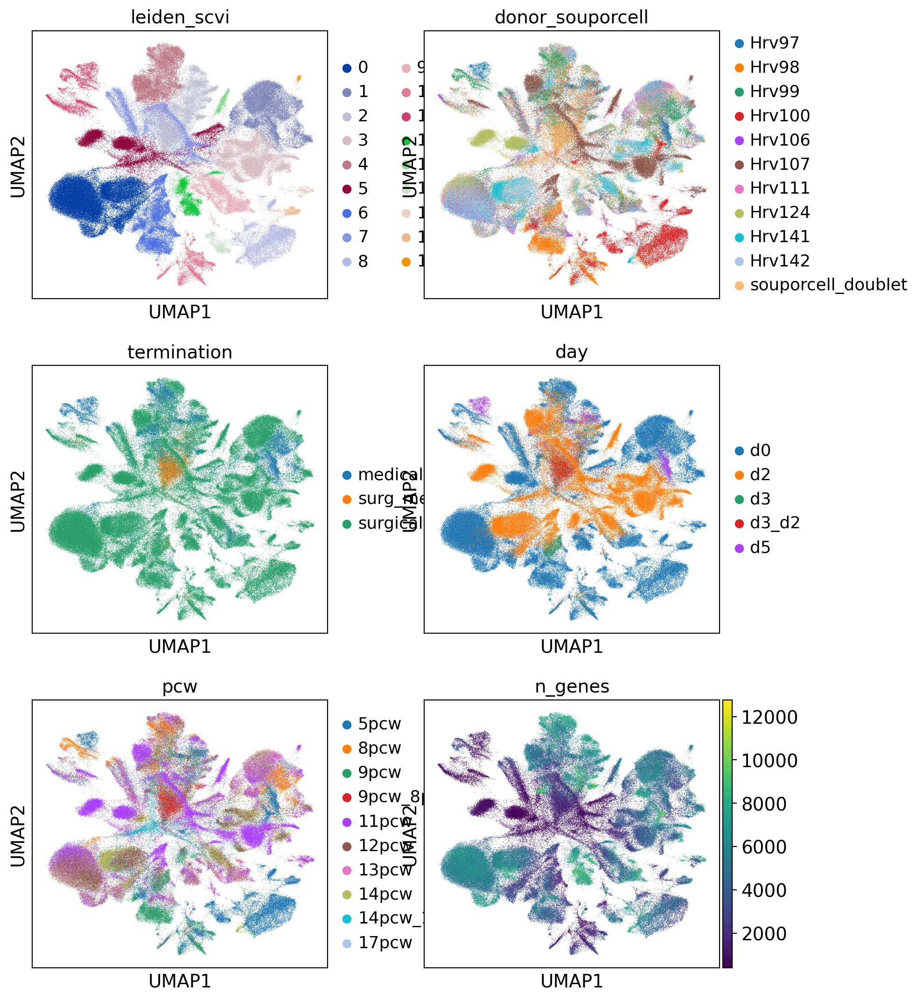

In [8]:
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="leiden_scvi", resolution=0.3)

# use scVI imputed values for plotting
sc.pl.umap(adata, color=["leiden_scvi",'donor_souporcell', 'termination', 
                         'day','pcw','n_genes' ], ncols=2)

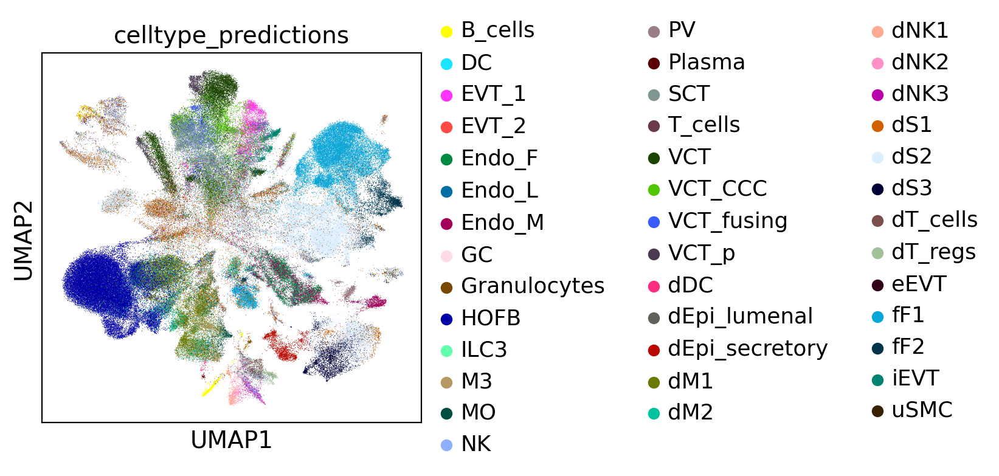

In [9]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=['celltype_predictions' ], save='_scVI_latent30_labTransfering.pdf')

In [15]:
sc.set_figure_params(figsize=(6,6))

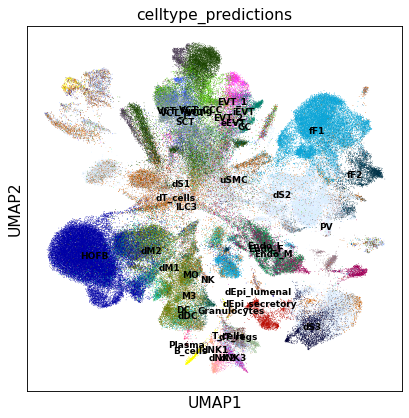

In [18]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=['celltype_predictions' ], legend_loc='on data',legend_fontsize='xx-small',
           size=1.5, save='_scVI_latent30_labTransfering2.pdf')

---

## Adding SoC Maternal-Foetal annotation

In [121]:
samples = list(np.unique(adata.obs['sample']))

In [122]:
#removing samples without SoC run
for sample in [ 'Pla_HDBR10917732','Pla_HDBR12808829','Pla_HDBR12808831']:
    samples.remove(sample)
    
    #Pla_HDBR10917732, Pla_HDBR12808829, Pla_HDBR12808831 are a special case and will be loaded separately
    # as it has k=4 (multiplexed samples & maternal-foetal genotype)

In [123]:
samples

['Pla_HDBR10917729',
 'Pla_HDBR10917730',
 'Pla_HDBR10917731',
 'Pla_HDBR10917733',
 'Pla_HDBR10917734',
 'Pla_HDBR11345027',
 'Pla_HDBR11345028',
 'Pla_HDBR11345030',
 'Pla_HDBR11345031',
 'Pla_HDBR11345032',
 'Pla_HDBR11345033',
 'Pla_HDBR12808826',
 'Pla_HDBR12808827']

In [124]:
# reading in souporcell outputs
# sample to cluster. saving in a dictionary
souporcell_clusters = {}


for sample in samples:
    print('sample', sample)
    path = '../data/souporcell/maternal_foetal/'+sample+'/clusters.tsv' #path to the souporcell output
    souporcell_clusters[sample] = pd.read_csv(path, sep='\t') #read souporcell output as pandas DF
    #aadind the DF into the dictionary
    souporcell_clusters[sample]['sample_barcode'] = [sample+'_'+j for j in souporcell_clusters[sample]['barcode']]
    souporcell_clusters[sample]['sample_barcode'] = [elem.split('-')[0] for elem in souporcell_clusters[sample]['sample_barcode']]
    souporcell_clusters[sample].set_index('sample_barcode', drop=False, inplace=True)

sample Pla_HDBR10917729
sample Pla_HDBR10917730
sample Pla_HDBR10917731
sample Pla_HDBR10917733
sample Pla_HDBR10917734
sample Pla_HDBR11345027
sample Pla_HDBR11345028
sample Pla_HDBR11345030
sample Pla_HDBR11345031
sample Pla_HDBR11345032
sample Pla_HDBR11345033
sample Pla_HDBR12808826
sample Pla_HDBR12808827


In [34]:
adata.obs['sample_barcode'] = adata.obs.index

In [36]:
adata.obs.head()

,sample,donor,termination,day,pcw,percent_mito,n_counts,batch,n_genes,sample_barcode,...,G2M_score,phase,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,scrublet_doublet,leiden_scvi,celltype_predictions,probabilities
Pla_HDBR10917729_AAACCCACATCGAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.004617,6715.0,0,1938,Pla_HDBR10917729_AAACCCACATCGAACT,...,-0.228714,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.979785
Pla_HDBR10917729_AAACCCAGTAAGACCG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.008159,858.0,0,449,Pla_HDBR10917729_AAACCCAGTAAGACCG,...,0.299731,G2M,0,0,9.330803,1.336784,singlet,11,PV,0.664456
Pla_HDBR10917729_AAACCCAGTGGGATTG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.005693,1581.0,0,779,Pla_HDBR10917729_AAACCCAGTGGGATTG,...,-0.084019,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.387121
Pla_HDBR10917729_AAACGAAAGCCTAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.047304,3023.0,0,1178,Pla_HDBR10917729_AAACGAAAGCCTAACT,...,0.865733,G2M,0,0,9.330803,1.336784,singlet,11,dS1,0.310120
Pla_HDBR10917729_AAACGAAAGCCTGGAA,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.066152,11005.0,0,3605,Pla_HDBR10917729_AAACGAAAGCCTGGAA,...,-0.146854,S,0,0,9.330803,1.336784,singlet,1,fF1,0.940927


In [125]:
#Adding the SoC pooled status
#%%time

adata.obs['souporcell_MFgenotype'] = adata.obs['sample_barcode'].apply(lambda x: add_souporcell_id(adata,x,souporcell_clusters))

In [44]:
adata.obs.head()

,sample,donor,termination,day,pcw,percent_mito,n_counts,batch,n_genes,sample_barcode,...,phase,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,scrublet_doublet,leiden_scvi,celltype_predictions,probabilities,souporcell_MFgenotype
Pla_HDBR10917729_AAACCCACATCGAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.004617,6715.0,0,1938,Pla_HDBR10917729_AAACCCACATCGAACT,...,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.979785,0
Pla_HDBR10917729_AAACCCAGTAAGACCG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.008159,858.0,0,449,Pla_HDBR10917729_AAACCCAGTAAGACCG,...,G2M,0,0,9.330803,1.336784,singlet,11,PV,0.664456,0
Pla_HDBR10917729_AAACCCAGTGGGATTG,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.005693,1581.0,0,779,Pla_HDBR10917729_AAACCCAGTGGGATTG,...,S,0,0,9.330803,1.336784,singlet,7,VCT_CCC,0.387121,0
Pla_HDBR10917729_AAACGAAAGCCTAACT,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.047304,3023.0,0,1178,Pla_HDBR10917729_AAACGAAAGCCTAACT,...,G2M,0,0,9.330803,1.336784,singlet,11,dS1,0.310120,0
Pla_HDBR10917729_AAACGAAAGCCTGGAA,Pla_HDBR10917729,Hrv97,medical,d5,5pcw,0.066152,11005.0,0,3605,Pla_HDBR10917729_AAACGAAAGCCTGGAA,...,S,0,0,9.330803,1.336784,singlet,1,fF1,0.940927,0/1


In [49]:
adata

AnnData object with n_obs × n_vars = 196363 × 32743
    obs: 'sample', 'donor', 'termination', 'day', 'pcw', 'percent_mito', 'n_counts', 'batch', 'n_genes', 'sample_barcode', 'souporcell_id', 'donor_deconv', 'donor_souporcell', 'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'scrublet_doublet', 'leiden_scvi', 'celltype_predictions', 'probabilities', 'souporcell_MFgenotype'
    var: 'gene_ids', 'feature_types', 'n_cells'
    uns: '_scvi', 'day_colors', 'donor_souporcell_colors', 'leiden', 'leiden_scvi_colors', 'neighbors', 'pcw_colors', 'sample_colors', 'scrublet_doublet_colors', 'umap', 'termination_colors', 'celltype_predictions_colors', 'souporcell_MFgenotype_colors'
    obsm: 'X_scVI_n_latent_10', 'X_scVI_n_latent_20', 'X_scVI_n_latent_30', 'X_scVI_n_latent_40', 'X_umap', '_scvi_extra_categoricals'
    layers: 'raw_counts'
    obsp: '

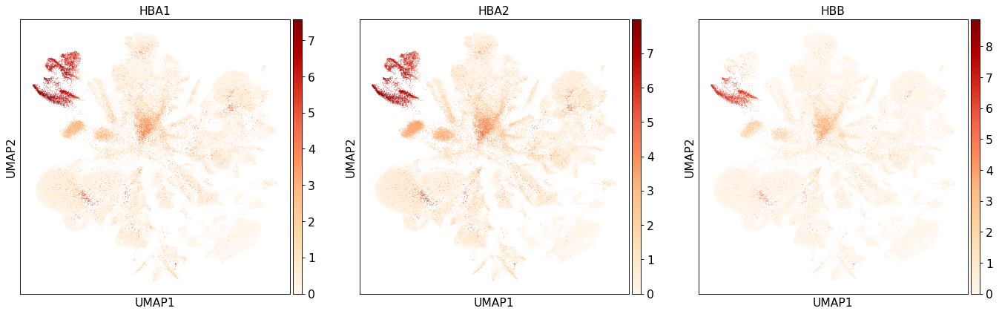

In [52]:
sc.pl.umap(adata, color=['HBA1','HBA2','HBB',],color_map='OrRd',size=1.5)

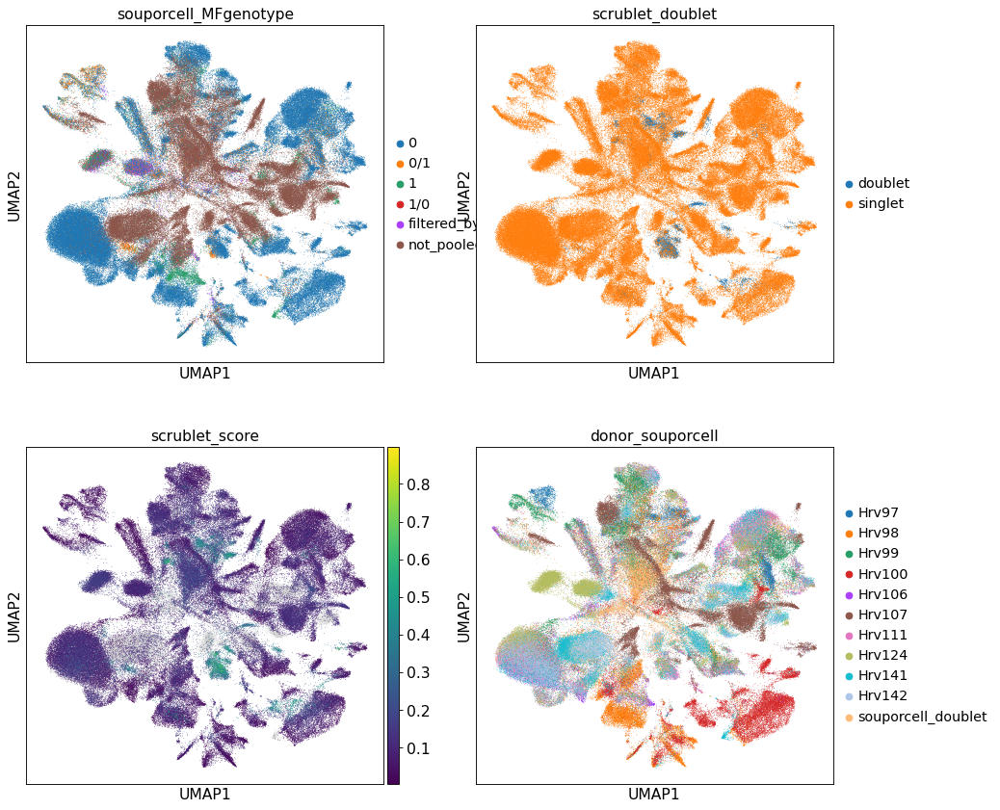

In [50]:
sc.pl.umap(adata, color=["souporcell_MFgenotype","scrublet_doublet","scrublet_score", 'donor_souporcell'],
           ncols=2, size=1.5)

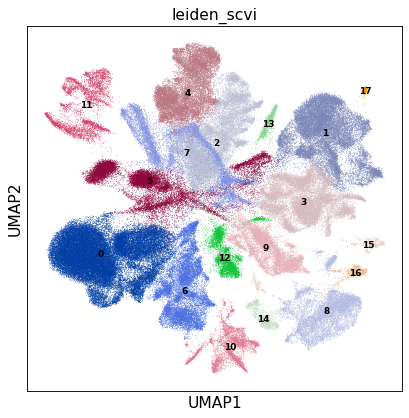

In [47]:
sc.pl.umap(adata, color=["leiden_scvi",],legend_loc='on data',legend_fontsize='xx-small', ncols=2, size=1.5)

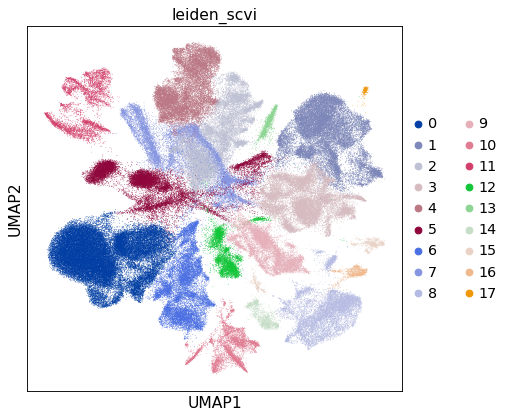

In [53]:
sc.pl.umap(adata, color=["leiden_scvi",], ncols=2, size=1.5)

## Cluster pre-labeling

The marker genes already reported for different cell types were intensively analysed, together with the clusters' markers, and the label trasfering.

As a result the following identities were assigned:
0: HB
1: Fibroblasts
2: Trophoblasts & doublets
3: dS
4: Trophoblasts
5: dS
6: dM
7: doublets
8: dS
9: Endo
10: T, B & NK cells
11: Erythrocytes
12: doublets
13: Unknown
14: Epi
15: Unknown2
16: Endo
17: Unknown3


In [54]:
#COpying the value of the leiden cluster. The new column will help to change it's values for
# the cluster identity
adata.obs['identity']= adata.obs['leiden_scvi']

In [55]:
adata.obs['identity']

Pla_HDBR10917729_AAACCCACATCGAACT     7
Pla_HDBR10917729_AAACCCAGTAAGACCG    11
Pla_HDBR10917729_AAACCCAGTGGGATTG     7
Pla_HDBR10917729_AAACGAAAGCCTAACT    11
Pla_HDBR10917729_AAACGAAAGCCTGGAA     1
                                     ..
Pla_HDBR12808831_TTTGTTGTCCAAGAGG     0
Pla_HDBR12808831_TTTGTTGTCGGTCATA     3
Pla_HDBR12808831_TTTGTTGTCTCGACGG     0
Pla_HDBR12808831_TTTGTTGTCTGTGCTC     0
Pla_HDBR12808831_TTTGTTGTCTTTCTAG     5
Name: identity, Length: 196363, dtype: category
Categories (18, object): ['0', '1', '2', '3', ..., '14', '15', '16', '17']

In [57]:
adata.obs['identity'] = (adata.obs["leiden_scvi"].map(lambda x: 
                            {"0": "HB", "1": "Fibroblasts", "2": "Trophoblasts & doublets'", "3": "dS",
                             "4": "Trophoblasts", "5": "dS", "6": "dM", "7": "doublets", "8": "dS",
                             "9": "Endo", "10": "T, B & NK cells", "11": "Ery", "12": "doublets", "13": "Unk",
                             "14": "Epi", "15": "Unk2", "16": "Endo", "17": "Unk3"}
                            .get(x, x)).astype("category"))


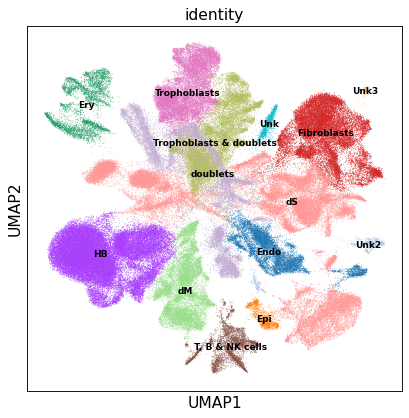

In [60]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['identity' ], legend_loc='on data',legend_fontsize='xx-small', size=1.5,
           save='_scVI_latent30_indentityDirty.pdf')

## Removal of scrublet doublets, doublet cluster, and Erythrocytes

In [61]:
adata = adata[adata.obs['identity'] != 'doublets']
adata = adata[adata.obs['scrublet_doublet'] != 'doublet']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


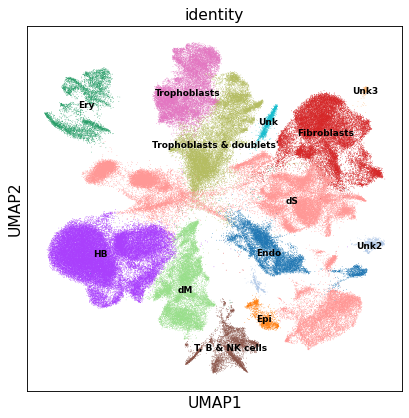

In [62]:
sc.pl.umap(adata, color=['identity' ], legend_loc='on data',legend_fontsize='xx-small', size=1.5)

## Re-running Clustering after doublets were deleted

In [63]:
#LATENT 30
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:42)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:06)


In [64]:
#clustering. Increasing resolution to separate doublets and delete them.
sc.tl.leiden(adata, key_added="leiden_scvi", resolution=0.4)

running Leiden clustering
    finished: found 27 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:55)


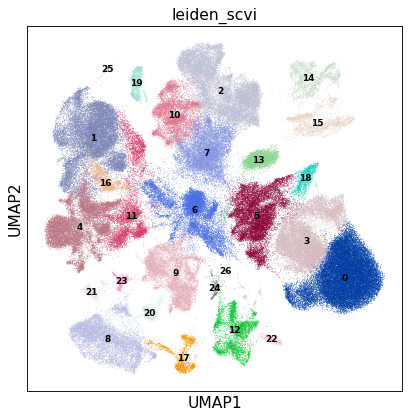

In [66]:
sc.pl.umap(adata, color=["leiden_scvi"],legend_loc='on data',legend_fontsize='xx-small', size=1.5)

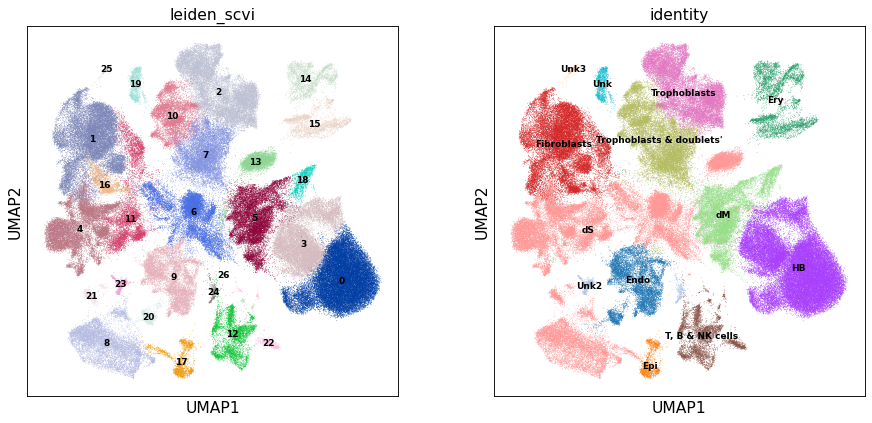

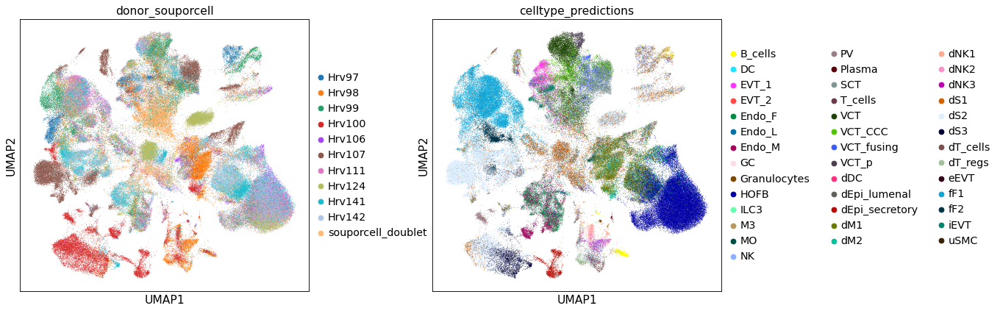

In [72]:
sc.pl.umap(adata, color=["leiden_scvi",'identity'], legend_loc='on data',legend_fontsize='xx-small',size=1.5)

sc.pl.umap(adata, color=['donor_souporcell','celltype_predictions'], wspace=0.3, size=1.5,)

In [73]:
#Deleting the doublets: in this case I can easily overlap the doublets identified by SoC
# and the cluster corresponding to them

adata = adata[adata.obs['leiden_scvi'] != '7']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [89]:
## Re-running the clustering now that most of the doublets were deleted

#LATENT 30
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:26)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:07)


In [90]:
#clustering. Increasing resolution to separate doublets and delete them.
sc.tl.leiden(adata, key_added="leiden_scvi", resolution=0.3)

running Leiden clustering
    finished: found 20 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:36)


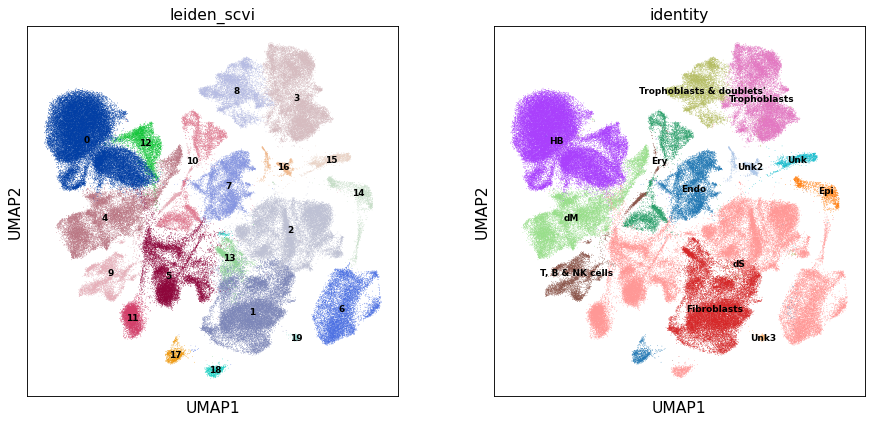

In [91]:
sc.pl.umap(adata, color=["leiden_scvi",'identity'], ncols=2, legend_loc='on data',legend_fontsize='xx-small', size=1.5)

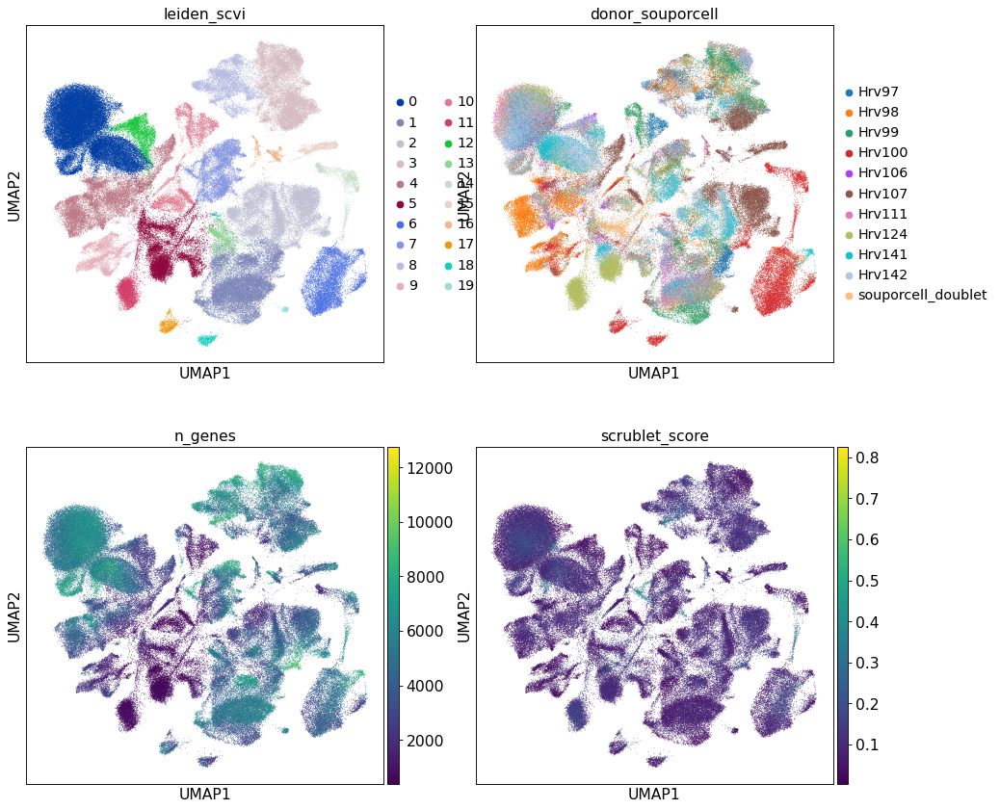

In [92]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=["leiden_scvi",'donor_souporcell',
                         'n_genes','scrublet_score' ], ncols=2, size=1.5)

Saving the object semi-clean

In [93]:
adata.write('../results/scVI/S5_scVIintegrated_adata_latent30_noDoublets_20220523.h5ad')

In [94]:
print('Total number of cells: {:d}'.format(adata.n_obs))

Total number of cells: 165451


## Clusters Fine labeling

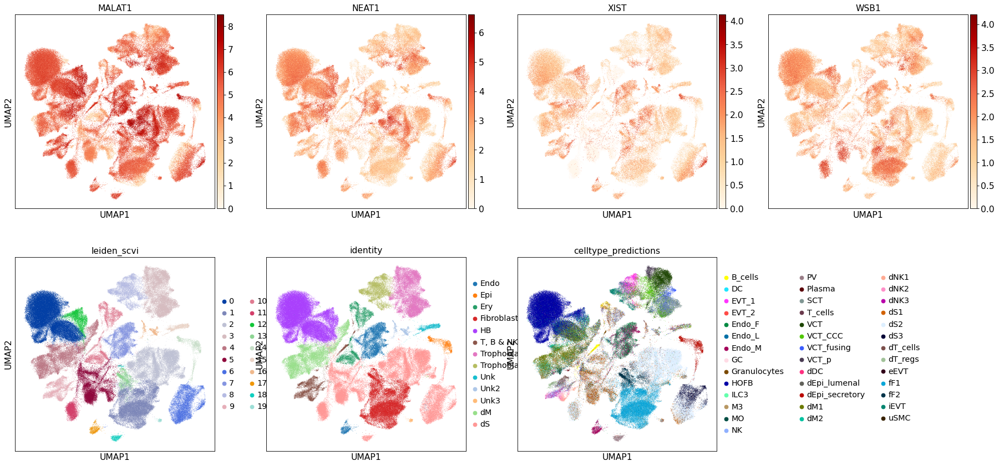

In [109]:
sc.pl.umap(adata, color=['MALAT1', 'NEAT1', 'XIST', 'WSB1','leiden_scvi', 'identity', 'celltype_predictions'],color_map='OrRd', size=1.5)

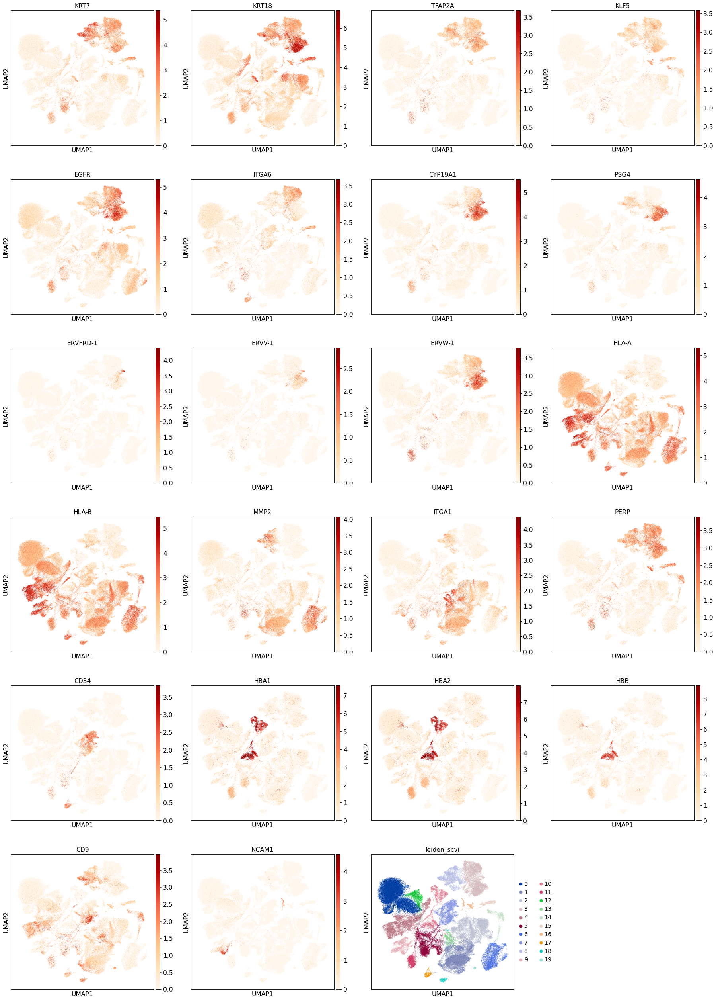

In [97]:
sc.pl.umap(adata, color=['KRT7','KRT18', 'TFAP2A', #trophoblasts
                         'KLF5', 'EGFR' ,'ITGA6', 'CYP19A1','PSG4','ERVFRD-1',
                         'ERVV-1','ERVW-1',#SCT
                         'HLA-A','HLA-B', 'MMP2', 'ITGA1', 'PERP', 'CD34',
                         'HBA1','HBA2','HBB',#Erythrocytes
                         'CD9','NCAM1','leiden_scvi'],color_map='OrRd', size=1.5,
           save='_otherMarkers_scVI_latent30.pdf')

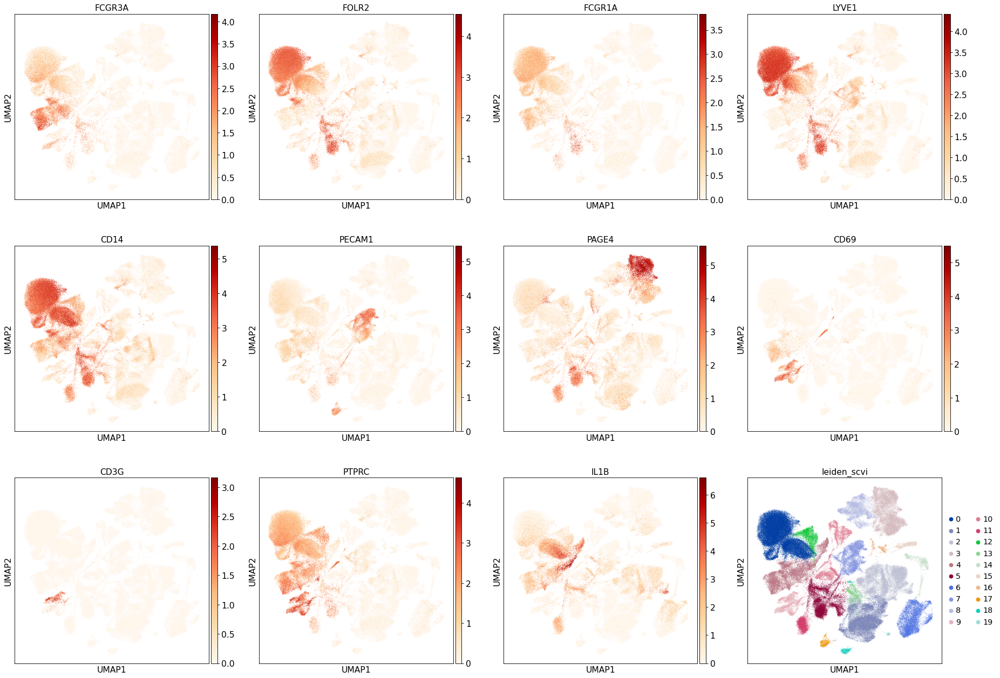

In [104]:
#placenta Immune markers
sc.pl.umap(adata, color=['FCGR3A', 'FOLR2', 'FCGR1A', 'LYVE1', 'CD14','PECAM1','PAGE4',
                         'CD69', 'CD3G','PTPRC','IL1B','leiden_scvi'],color_map='OrRd',size=1.5,
           save='_placentaImmuneMarkers_scVI_latent30.pdf')

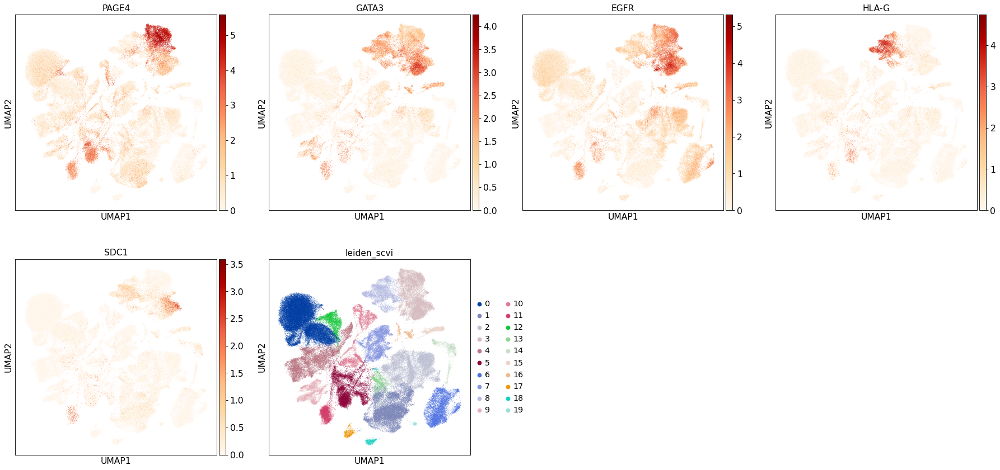

In [105]:
#trophoblats markers
sc.pl.umap(adata, color=['PAGE4', 'GATA3', 'EGFR', 'HLA-G','SDC1','leiden_scvi']
           ,color_map='OrRd',size=1.5, save='_trophoblastMarkers_scVI_latent30.pdf')

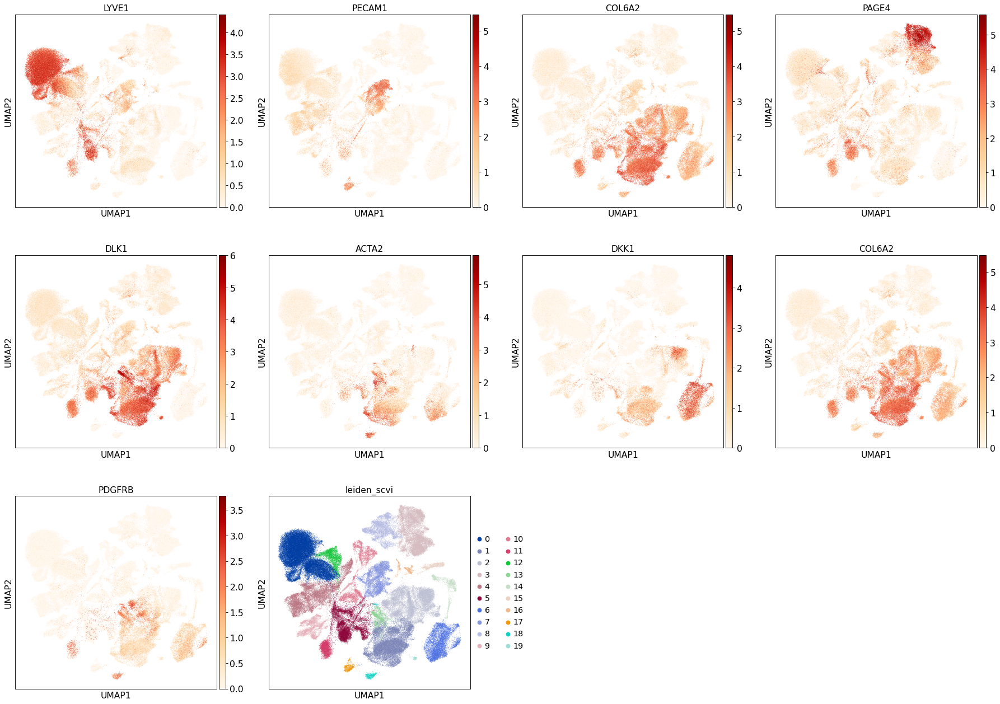

In [106]:
#placenta markers
sc.pl.umap(adata, color=['LYVE1', 'PECAM1', 'COL6A2', 'PAGE4',
                        'DLK1', 'ACTA2','DKK1', 'COL6A2','PDGFRB', 'leiden_scvi'],
           color_map='OrRd',size=1.5, save='_placentaMarkers_scVI_latent30.pdf')

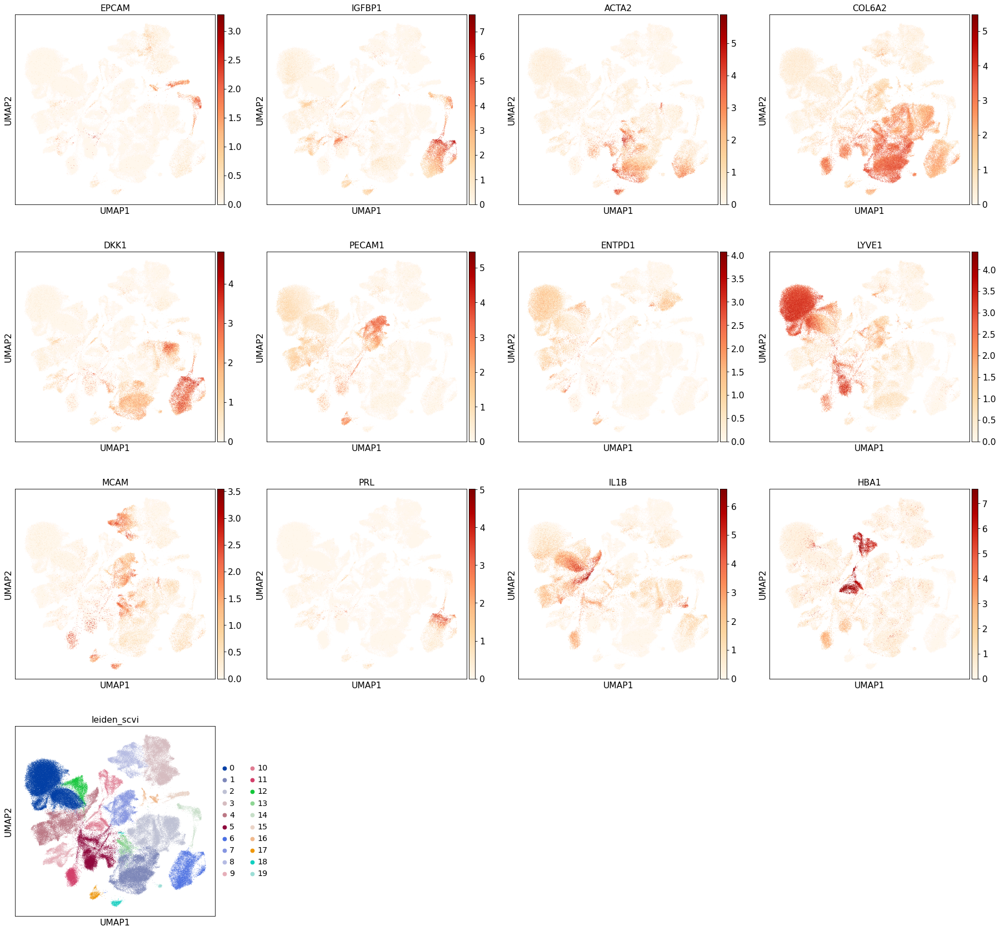

In [107]:
#decidua markers
sc.pl.umap(adata, color=['EPCAM', 'IGFBP1', 'ACTA2', 'COL6A2', 'DKK1','PECAM1','ENTPD1', 'LYVE1', 'MCAM',
                         'PRL','IL1B','HBA1',
                         'leiden_scvi'],color_map='OrRd',size=1.5, save='_deciduaMarkers_scVI_latent30.pdf')

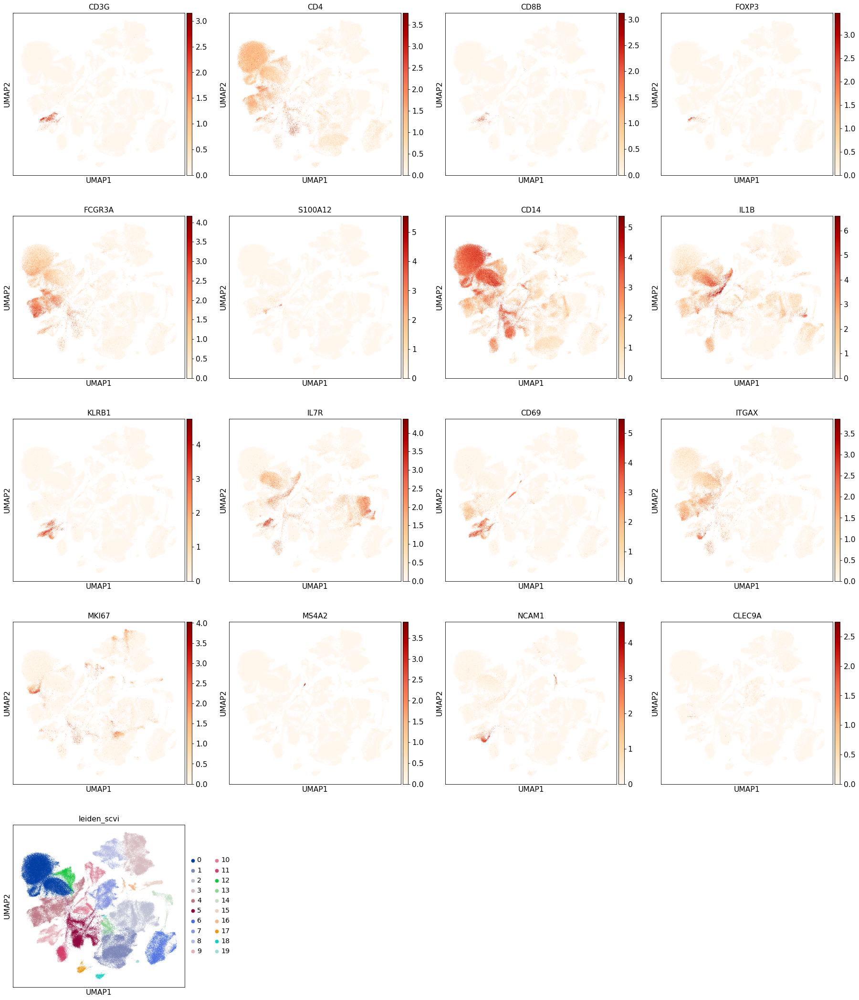

In [108]:
#Decidua Immune markers
sc.pl.umap(adata, color=[ 'CD3G', 'CD4', 'CD8B', 'FOXP3', 'FCGR3A','S100A12','CD14','IL1B',
                         'KLRB1','IL7R','CD69','ITGAX','MKI67','MS4A2','NCAM1', 'CLEC9A',
                         'leiden_scvi'],color_map='OrRd',size=1.5, save='_deciduaImmuneMarkers_scVI_latent30.pdf')

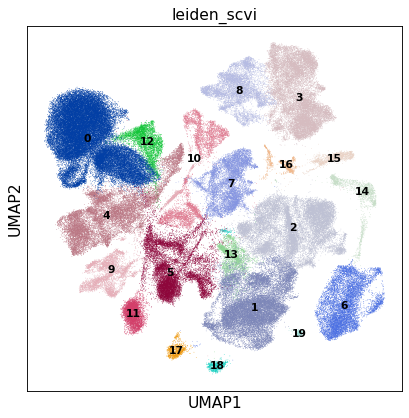

In [110]:
sc.pl.umap(adata, color=[ 'leiden_scvi'],ncols=2, legend_loc='on data',legend_fontsize='x-small',size=1.5)

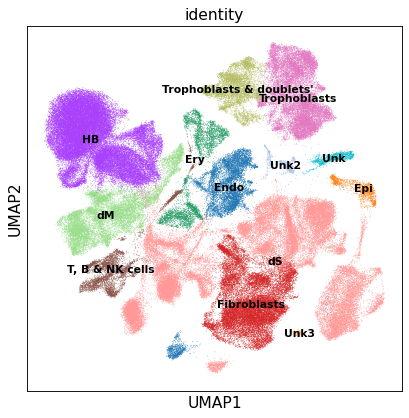

In [111]:
sc.pl.umap(adata, color=[ 'identity'],ncols=2, legend_loc='on data',legend_fontsize='x-small',size=1.5)

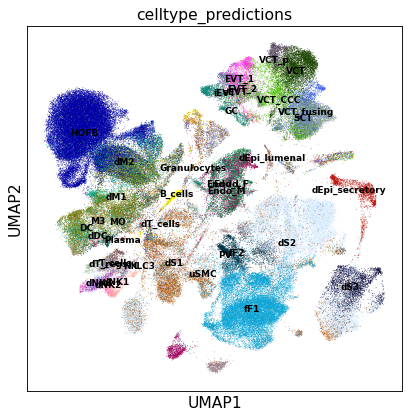

In [114]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=['celltype_predictions' ], size=1.5, legend_loc='on data',legend_fontsize='xx-small')#, save='_scVI_latent30_labTransfering3.pdf')

... storing 'souporcell_MFgenotype' as categorical


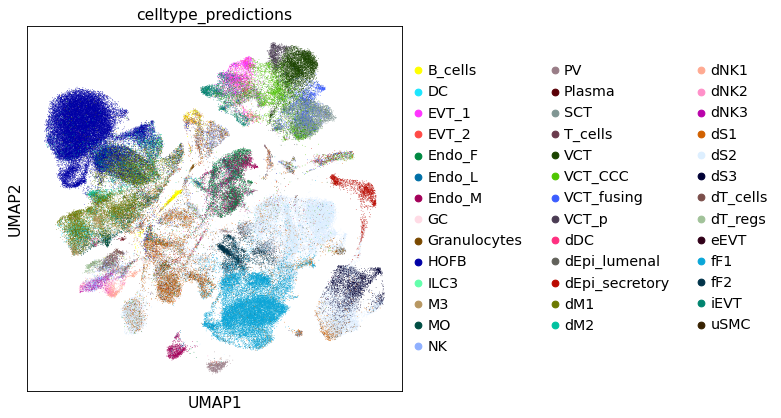

In [126]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=['celltype_predictions' ], size=1.5, save='_scVI_latent30_labTransfering3.1.pdf')

## Cluster 18

In [127]:
#Selecting the cells in cluster 18
temp_cells = adata[adata.obs['leiden_scvi'] == '18']


#Function that changes the cluster names as indicated
temp_cells.obs['identity'] = (temp_cells.obs["leiden_scvi"].map(lambda x: 
                            {"18": "PV"}
                            .get(x, x)).astype("category"))

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.obs` of view, copying.


In [130]:
### 
### converting categorical into strings to introduce new categories into the original adata object
adata.obs['identity']=adata.obs['identity'].astype("string")

#assigning the new categories to the cells in adata
for cell in temp_cells.obs.index:
    adata.obs['identity'][cell] = temp_cells.obs['identity'][cell]

#Returning strings into categorical 
adata.obs['identity']=adata.obs['identity'].astype("category")

In [41]:
#Removing remanent cells from the Unk5 cluster that doesn't match anywhere
#adata = adata[adata.obs['identity'] != 'Unk5']

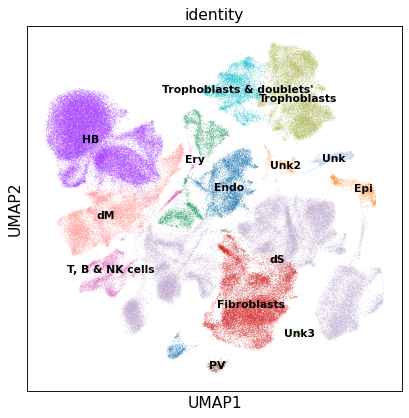

In [131]:
sc.pl.umap(adata, color=[ 'identity'],ncols=2, legend_loc='on data',legend_fontsize='x-small')

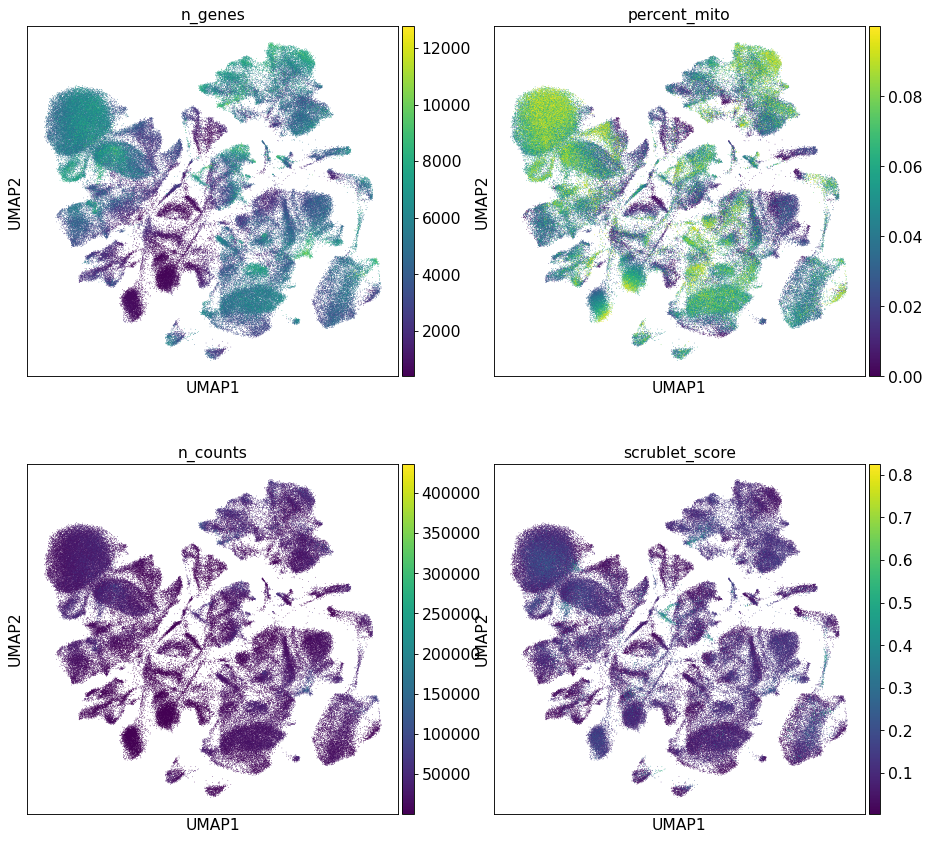

In [116]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=["n_genes",'percent_mito','n_counts',
                         'scrublet_score' ], size=1.5, ncols=2)

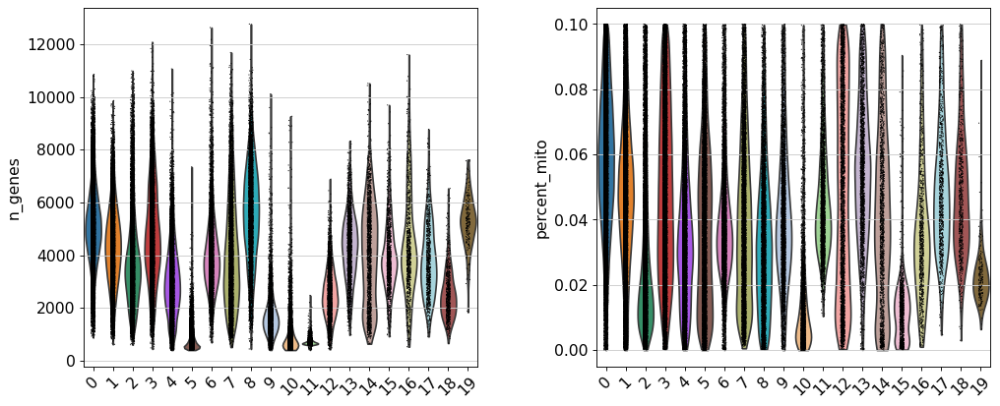

In [117]:
sc.pl.violin(adata, keys=["n_genes",'percent_mito'], groupby='leiden_scvi',rotation=45)

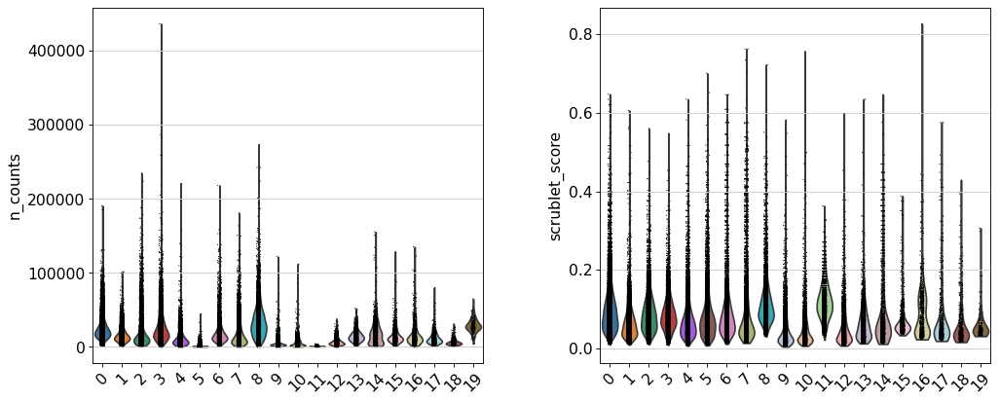

In [118]:
sc.pl.violin(adata, keys=["n_counts",'scrublet_score'], groupby='leiden_scvi',rotation=45)

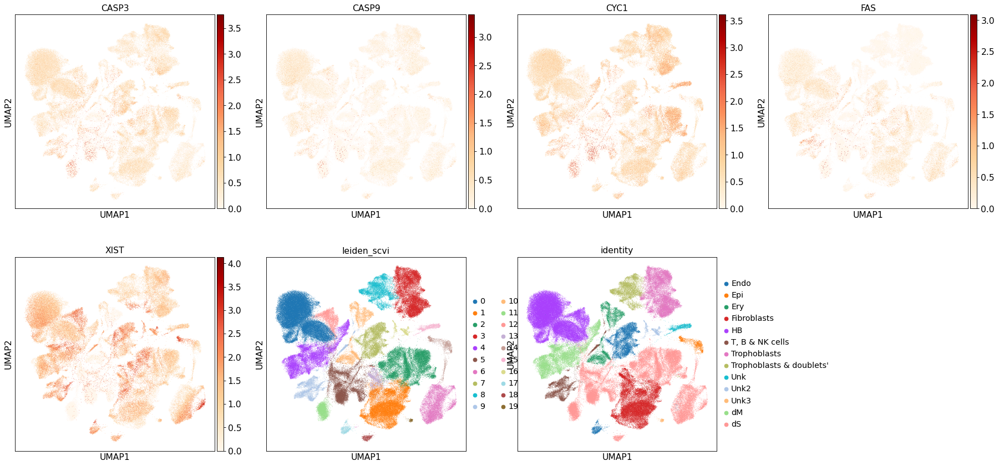

In [120]:
sc.pl.umap(adata, color=['CASP3', 'CASP9', 'CYC1','FAS','XIST', 'leiden_scvi', 'identity'],color_map='OrRd',size=1.5,
           save='_scVI_latent30_apoptosisMarkers.pdf')

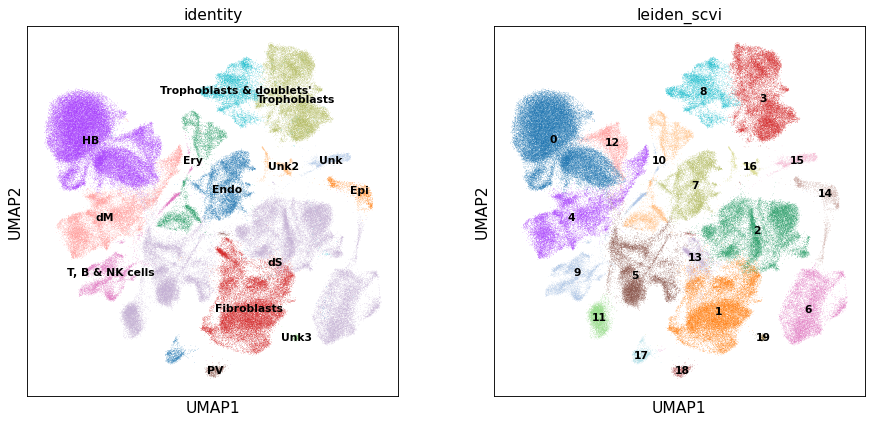

In [133]:
sc.pl.umap(adata, color=[ 'identity', 'leiden_scvi'],ncols=2, legend_loc='on data',legend_fontsize='x-small')

#### NOTE:
The  clusters 5, 11, 15, 16 & 19 express many of the reported clusters for different cell types tissue. They also have a higher proportion of mito genes and apoptotic gene, and a low number of expressed genes in total.  Therefore, I will remove these clusters.


In [134]:
adata = adata[adata.obs['leiden_scvi'] != '5']

adata = adata[adata.obs['leiden_scvi'] != '11']

adata = adata[adata.obs['leiden_scvi'] != '15']
adata = adata[adata.obs['identity'] != 'Unk']

adata = adata[adata.obs['leiden_scvi'] != '16']
adata = adata[adata.obs['identity'] != 'Unk2']

adata = adata[adata.obs['leiden_scvi'] != '19']
adata = adata[adata.obs['identity'] != 'Unk3']

In [50]:
adata = adata[adata.obs['identity'] != 'Unk4']

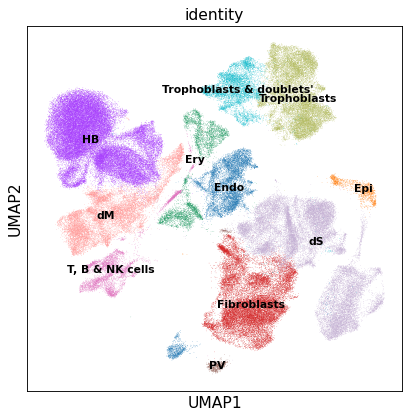

In [141]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['identity' ], legend_loc='on data',legend_fontsize='x-small')

In [142]:
#LATENT 30
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:33)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:43)


In [143]:
#clustering. Increasing resolution to separate doublets and delete them.
sc.tl.leiden(adata, key_added="leiden_scvi", resolution=0.3)

running Leiden clustering
    finished: found 18 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:38)


In [144]:
print('Total number of cells: {:d}'.format(adata.n_obs))

Total number of cells: 147751


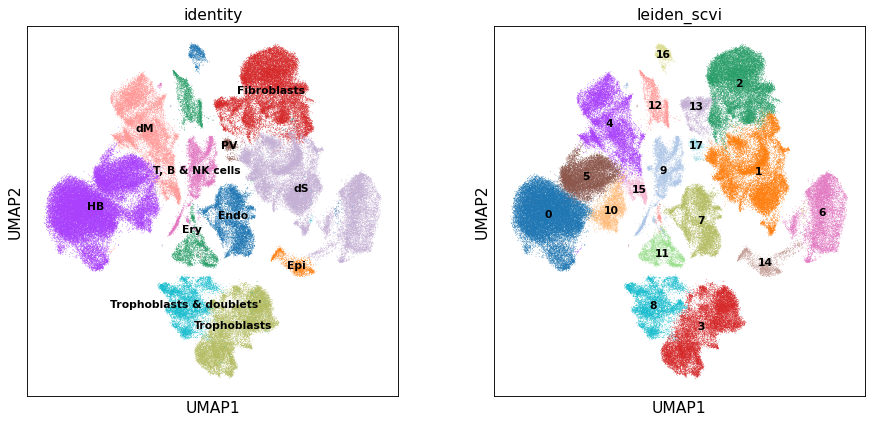

In [145]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['identity', 'leiden_scvi'], legend_loc='on data',legend_fontsize='x-small', size=1.5)

## Saving data

In [146]:
adata.write('../results/scVI/S5_scVIintegrated_adata_latent30_noDoublets_20220523.h5ad')

In [147]:
adata

AnnData object with n_obs × n_vars = 147751 × 32743
    obs: 'sample', 'donor', 'termination', 'day', 'pcw', 'percent_mito', 'n_counts', 'batch', 'n_genes', 'sample_barcode', 'souporcell_id', 'donor_deconv', 'donor_souporcell', 'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'scrublet_doublet', 'leiden_scvi', 'celltype_predictions', 'probabilities', 'souporcell_MFgenotype', 'identity'
    var: 'gene_ids', 'feature_types', 'n_cells'
    uns: '_scvi', 'day_colors', 'donor_souporcell_colors', 'leiden', 'neighbors', 'pcw_colors', 'sample_colors', 'scrublet_doublet_colors', 'umap', 'termination_colors', 'celltype_predictions_colors', 'souporcell_MFgenotype_colors', 'identity_colors', 'leiden_scvi_colors'
    obsm: 'X_scVI_n_latent_10', 'X_scVI_n_latent_20', 'X_scVI_n_latent_30', 'X_scVI_n_latent_40', 'X_umap', '_scvi_extra_categoricals'
    l